In [23]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../../../')

from plotting.main_plotting import preprocess_signals
from main import load_and_prepare_sessions
from analysis.timepoint_analysis import sample_signals_and_metrics


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


[autoreload of main failed: Traceback (most recent call last):
  File "/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
             ^^^^^^^^^^^^^^
  File "/Users/fsp585/anaconda3/envs/sund/lib/python3.11/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 621, in _exec
  File "<frozen importlib._bootstrap_external>", line 940, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/Users/fsp585/Desktop/GetherLabCode/FiberphotometryCode/project_root/notebooks/leonie/septempter_todo/../../../main.py", line 57, in <module>
    sessions = load_and_prepare_sessions("../Gq-DREADD_CPT_Training_Stages/Stage4/

In [24]:
from main import load_and_prepare_sessions
from processing.session_sampling import MiceAnalysis
from data.mouse import create_mice_dict
from plotting.main_plotting import plot_session_events_and_signal
from analysis.timepoint_analysis import sample_signals_and_metrics
from itertools import product
from config import all_event_types, all_brain_regions

import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.signal import savgol_filter
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from ipywidgets import FloatProgress

from analysis.timepoint_analysis import sample_signals_and_metrics
from analysis.timepoint_analysis import collect_sessions_data

import config

In [25]:
for stage in ['stage1', 'stage2', 'stage3', 'stage4']:
    for phase in ['pre', 'post']:
        curr_sessions = load_and_prepare_sessions("../../../../Gq-DREADD_CPT_Training_Stages", load_from_pickle=True, remove_bad_signal_sessions=True,
                                                  pickle_name=f'sessions_{stage}_{phase}')
        #title = stage + ' ' + phase
        for session in tqdm(curr_sessions):
            for brain_reg in session.brain_regions:
                pass
                # # Step 3: Create a Plotly figure object for subplots
                # # Adjust rows and cols based on your layout needs
                # fig = make_subplots(rows=1, cols=1)

                # title = f"genotype: {session.genotype}, dose: {session.drug_info['dose']}, brain region: {brain_reg}\
                #     \n{session.trial_id}, {stage}, {phase}"
                # plot_session_events_and_signal(session, brain_reg, fig, row=1, col=1, title_suffix=title)
                # #fig.write_image(f"{session.mouse_id}_{session.trial_id}_{brain_reg}.png")
                # #fig.show()

                # #fig = make_subplots(rows=1, cols=1)

                # #plot_session_events_and_signal(session, brain_reg, fig, row=1, col=1, title_suffix=title, smooth=True)
                # #fig.write_image(f"{session.mouse_id}_{session.trial_id}_{brain_reg}.png")
                # curr_fname = f"{session.mouse_id}_{session.trial_id}_{brain_reg}_{stage}_{phase}.html"
                # print(curr_fname)
                # fig.write_html(curr_fname)
                
    


  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

In [26]:
first_mice_sessions = load_and_prepare_sessions("../../../../Gq-DREADD_CPT_Training_Stages", load_from_pickle=True, remove_bad_signal_sessions=True,
                                                pickle_name=f'sessions_stage1_pre')
first_mice_ids = [s.mouse_id for s in first_mice_sessions]

In [27]:
brain_reg_to_color = {'LH': 'orange',
                      'mPFC': 'cornflowerblue'}

In [28]:
def preprocess_and_plot_signals(all_signals, event_type, brain_region, smoothing_len=10, title_suffix=None):
    # Assuming all_signals is predefined
    signals = all_signals

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['fps']
    
    xs = np.arange(-interval_start, interval_end) / fps
    
    # Smooth the mean signal
    ys = np.mean(signals, axis=0)
    window = np.ones(smoothing_len) / smoothing_len
    ys = np.convolve(ys, window, 'same')

    # Calculate the standard deviation of the mean
    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))

    # Use scipy.stats.norm.interval to get the 95% confidence interval
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)

    # The lower and upper bounds
    lb = ci_lower.min()
    ub = ci_upper.max()

    ylim = (lb, ub)
    
    # Assuming brain_reg_to_color is predefined
    color = brain_reg_to_color[brain_region]

    if title_suffix is None:
        title_suffix = ''
    plt.figure(dpi=300)
    plt.plot(xs, ys, color=color, label='Mean Signal')
    plt.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, label='95% CI')
    plt.ylim(ylim)
    title_name = f'{event_type}, {brain_region}, (n = {len(signals)}), {title_suffix}'
    plt.title(title_name)
    plt.xlabel('Time (s)')
    plt.ylabel('z-score')
    plt.legend()
    plt.grid()
    plt.savefig(title_name)
    plt.show()

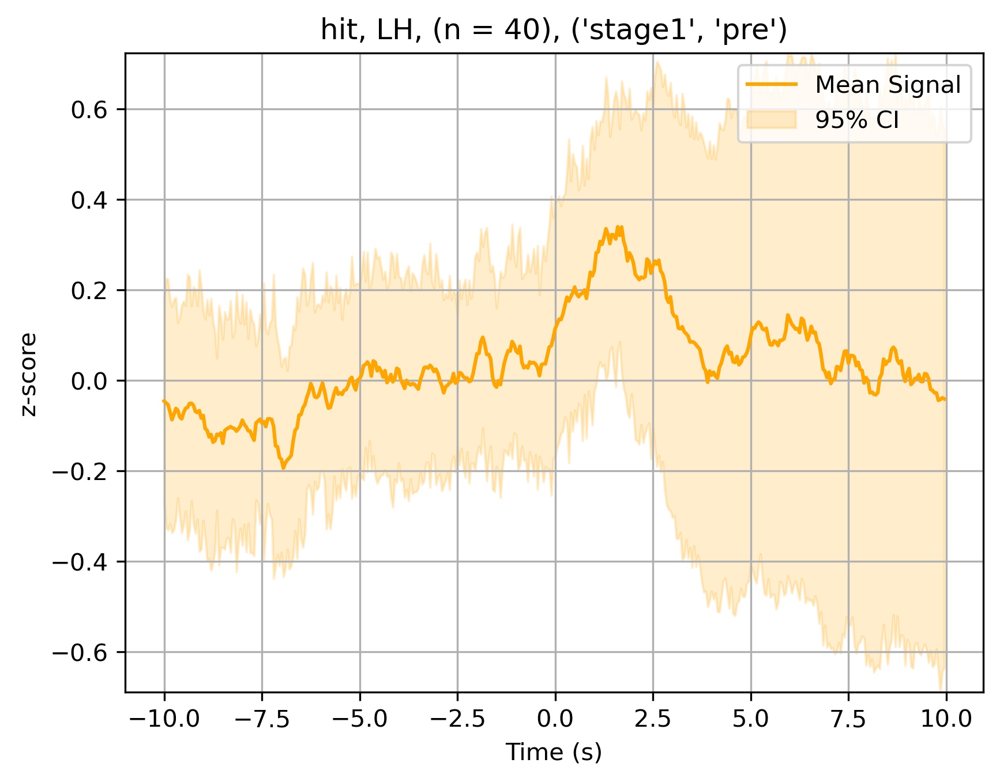

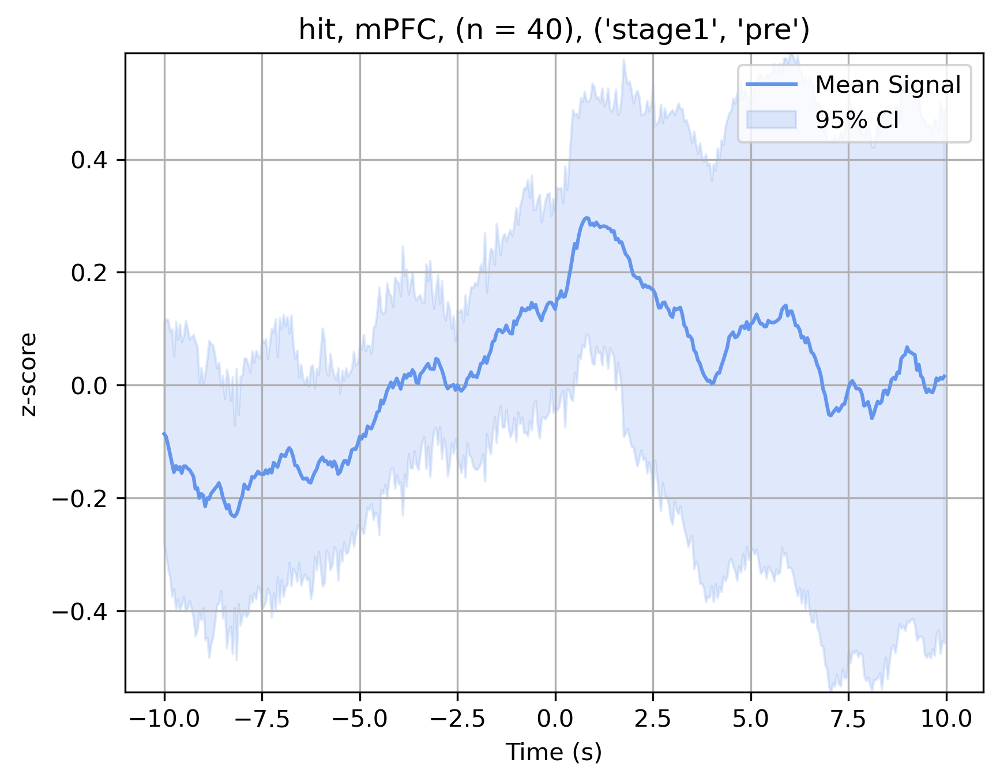

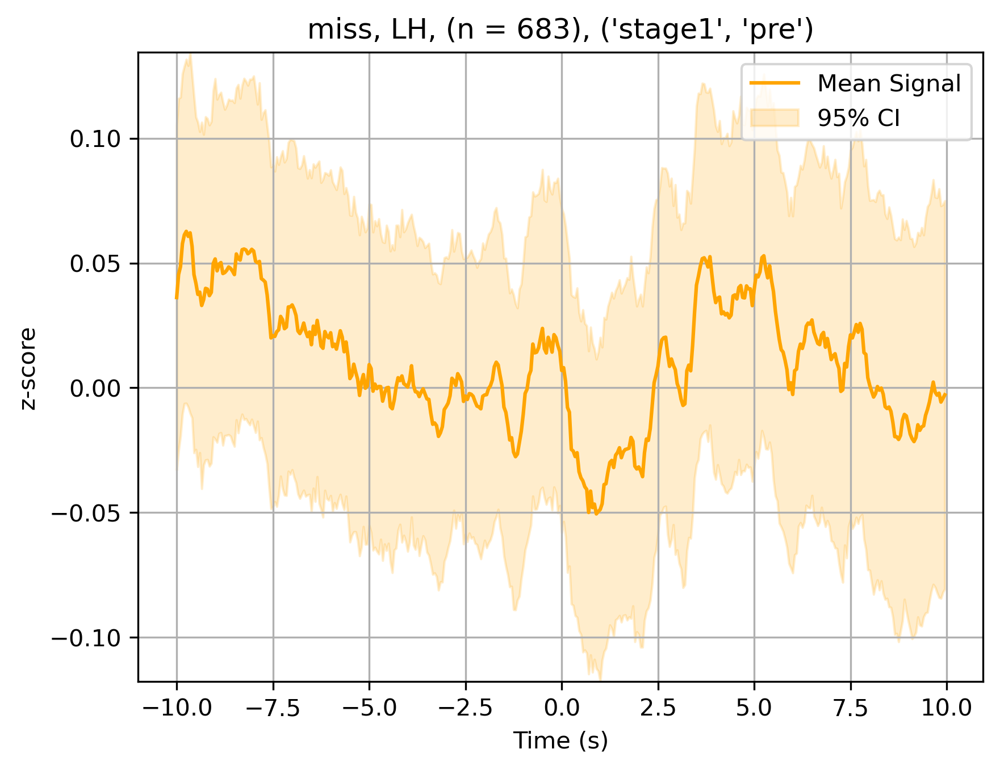

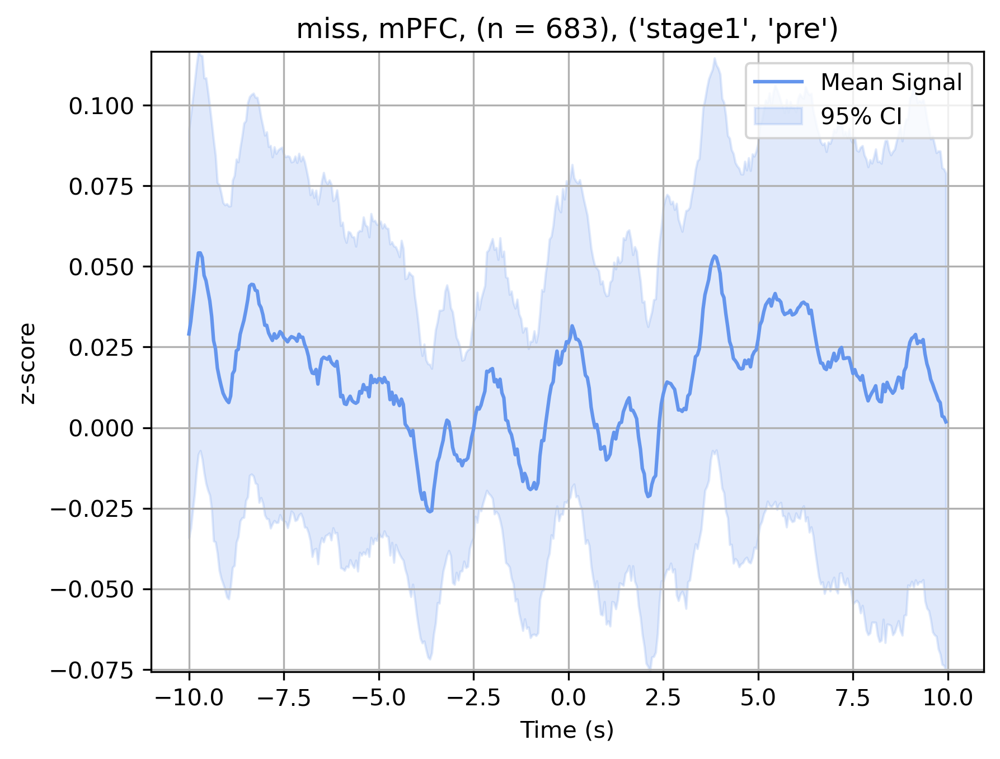

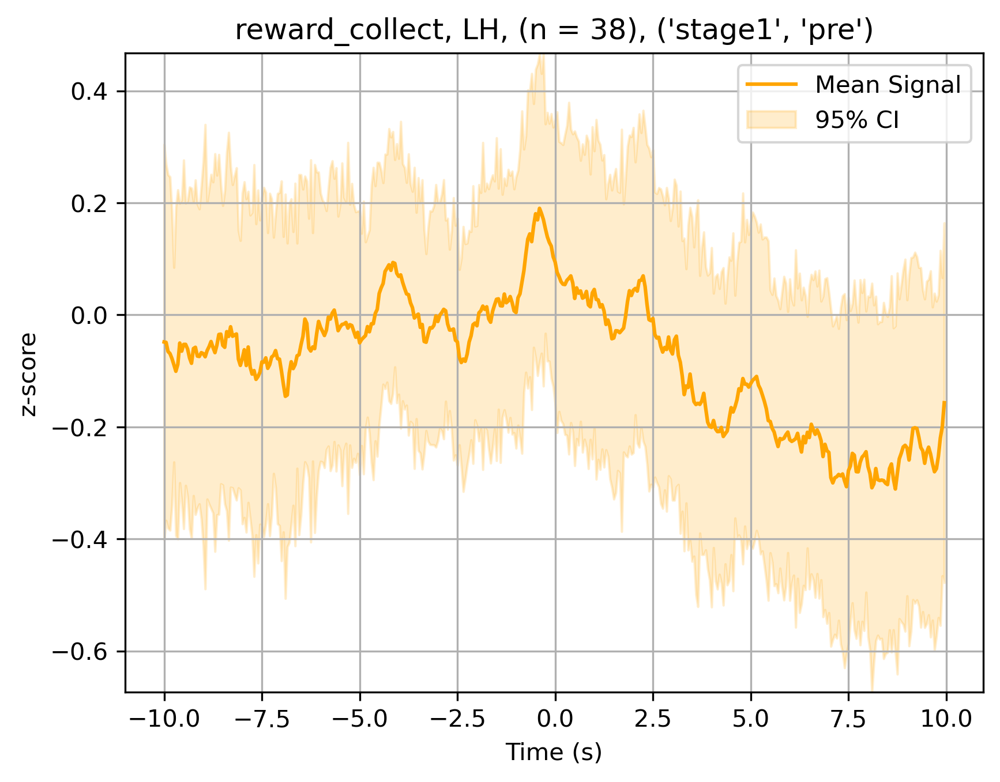

...

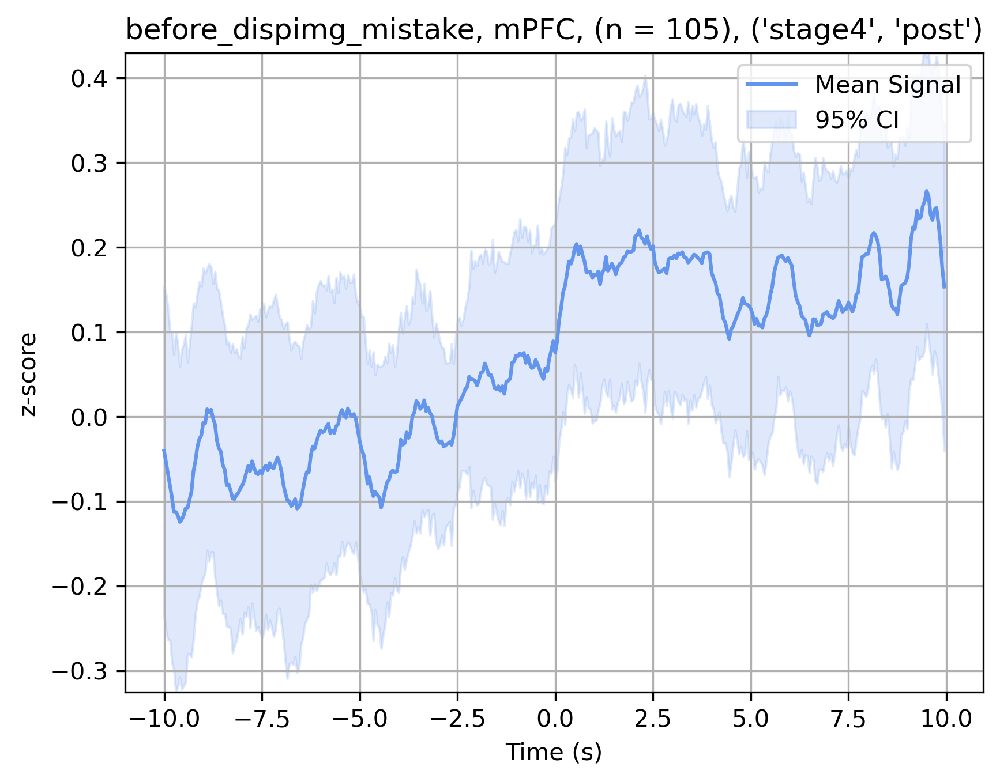

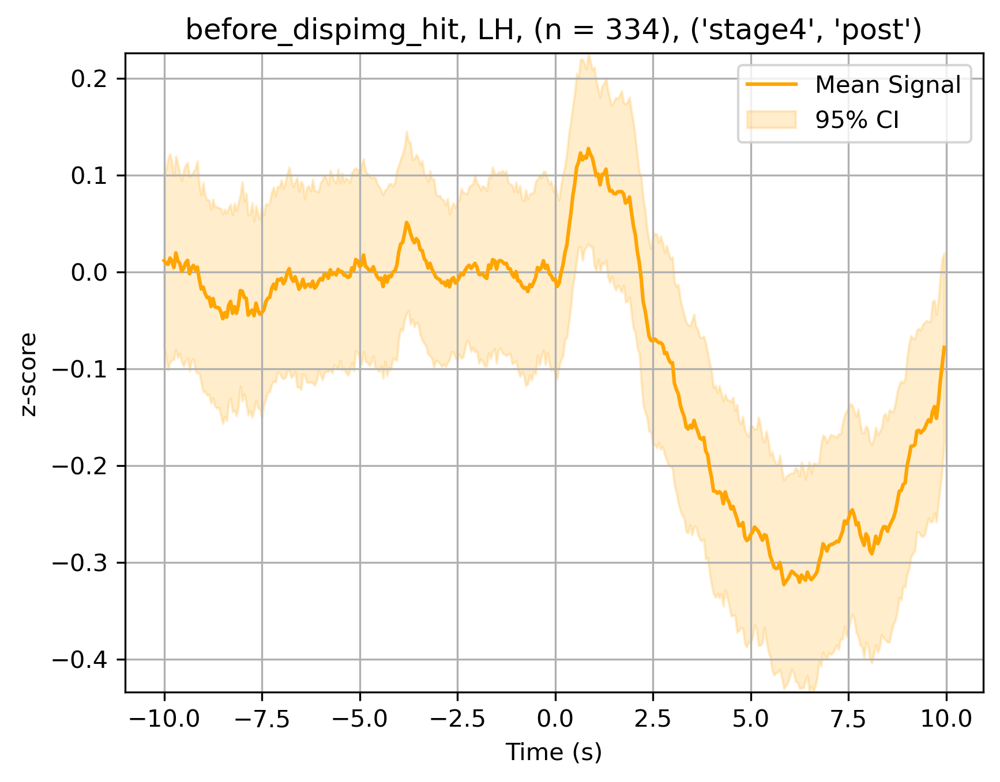

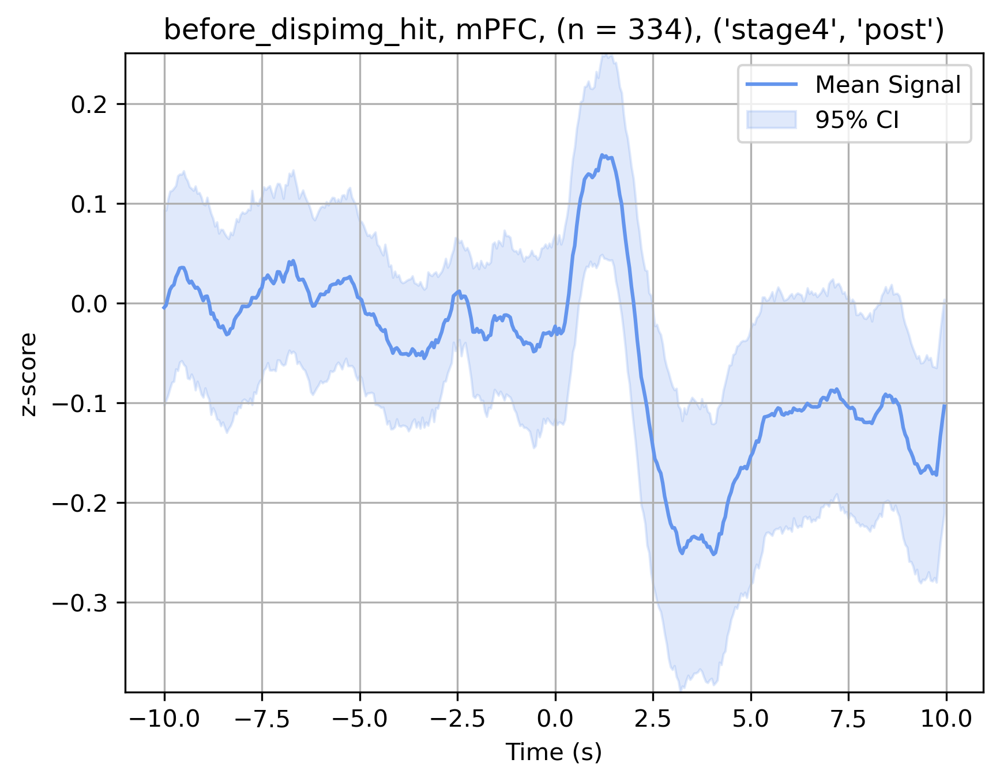

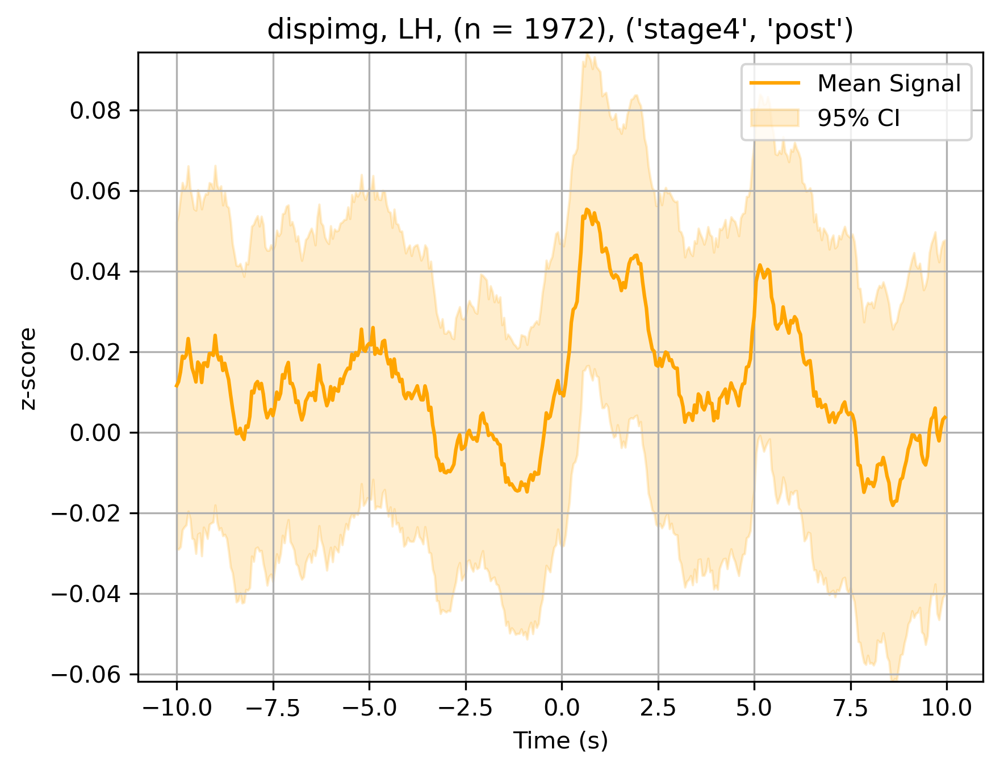

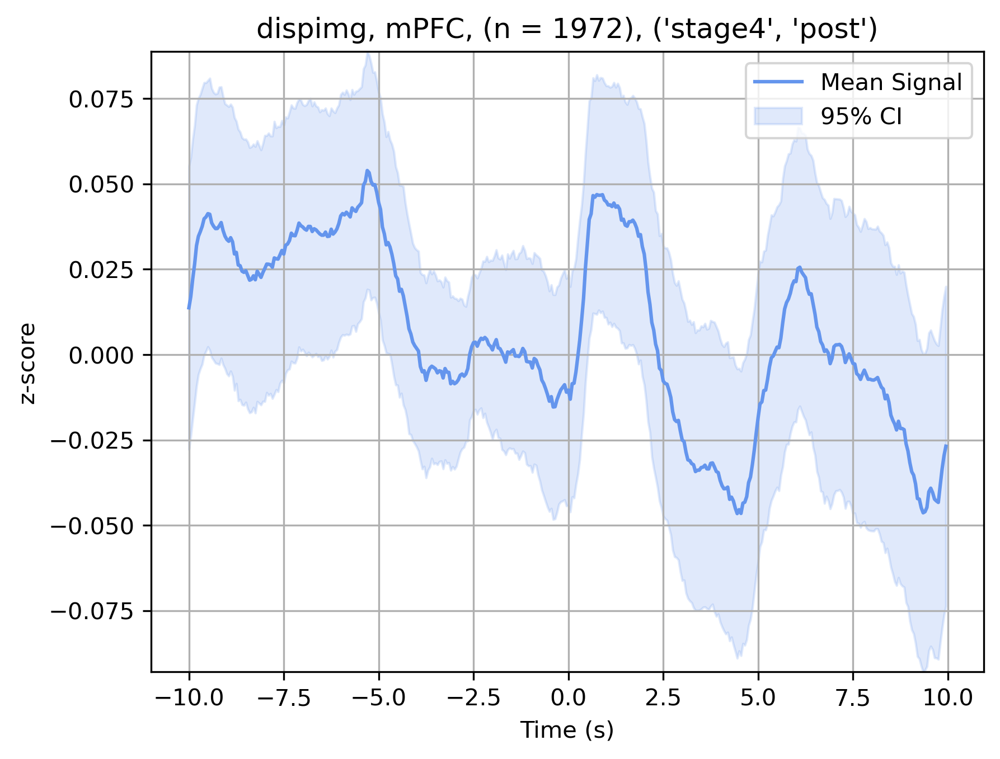

In [29]:
for stage in ['stage1', 'stage2', 'stage3', 'stage4']:
    for phase in ['pre', 'post']:
        curr_sessions = load_and_prepare_sessions("../../../../Gq-DREADD_CPT_Training_Stages", load_from_pickle=True, remove_bad_signal_sessions=True,
                                                  pickle_name=f'sessions_{stage}_{phase}')
        curr_sessions = [s for s in curr_sessions if s.mouse_id in first_mice_ids]
        for event in all_event_types:
            for brain_reg in all_brain_regions:
                if sample_signals_and_metrics(curr_sessions, event, brain_reg):
                    all_signals = sample_signals_and_metrics(curr_sessions, event, brain_reg)[0]
                    preprocess_and_plot_signals(all_signals, event, brain_reg, title_suffix=f'{stage, phase}')
                else:
                    continue
    
